In [34]:
pip install opencv-python


In [62]:
import cv2
import glob
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import base64
import json
from PIL import Image
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

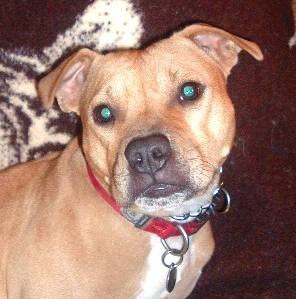

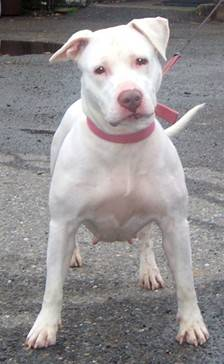

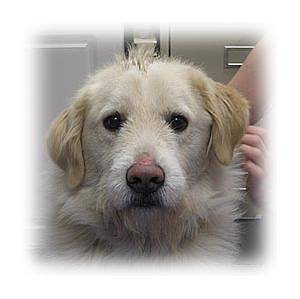

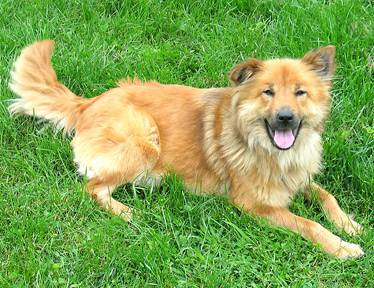

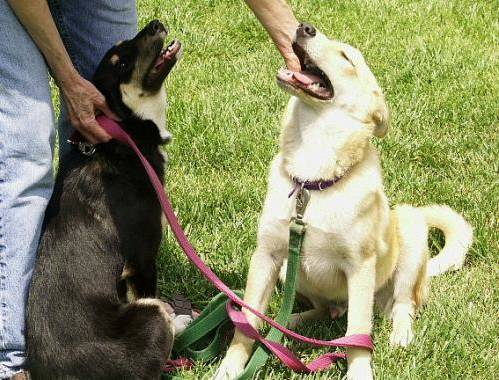

...

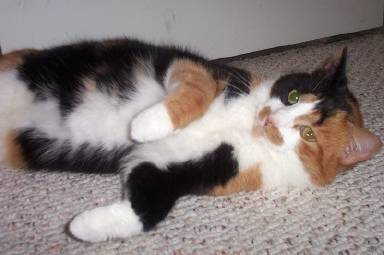

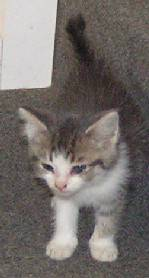

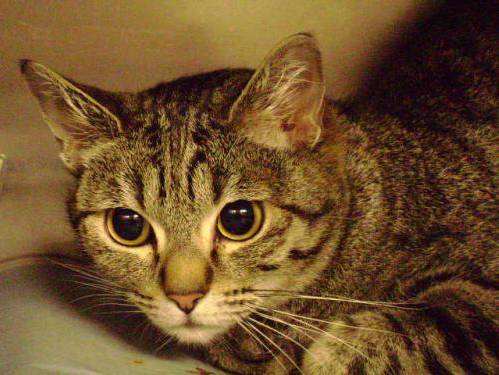

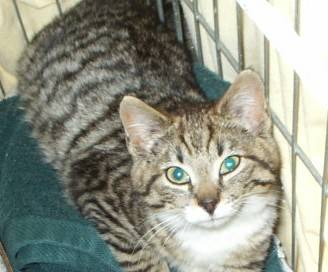

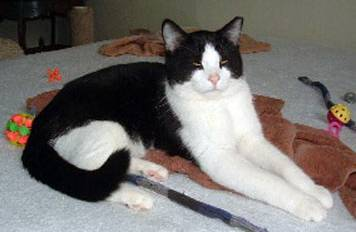

In [63]:
img_paths = ["/1.jpg", "/2.jpg", "/3.jpg", "/4.jpg", "/5.jpg", "/6.jpg", "/7.jpg", "/8.jpg", "/9.jpg", "/10.jpg", "/1.jpg", "/11.jpg", "/12.jpg", "/13.jpg", "/14.jpg", "/15.jpg", "/16.jpg"
,"/17.jpg", "/18.jpg", "/19.jpg", "/20.jpg"]

for img in img_paths:
  image = cv2.imread(img)
  cv2_imshow(image)
  cv2.waitKey(0)

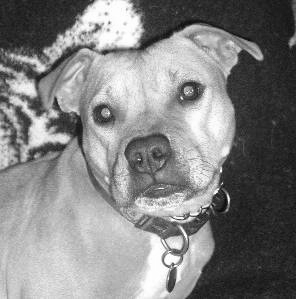

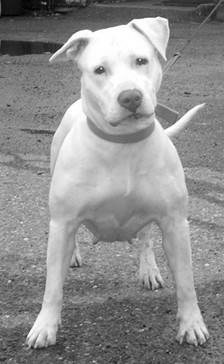

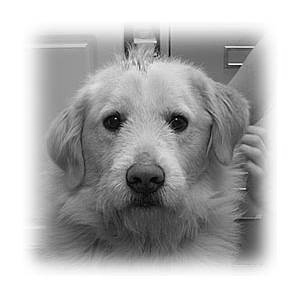

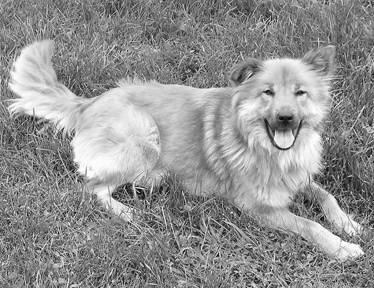

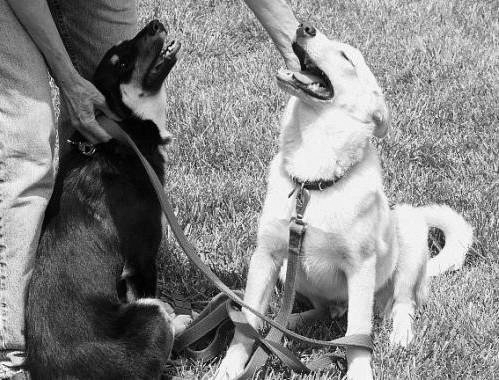

...

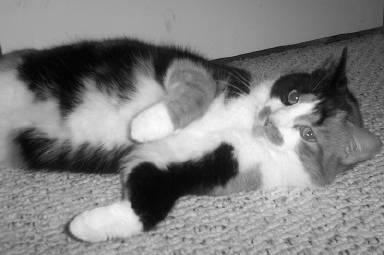

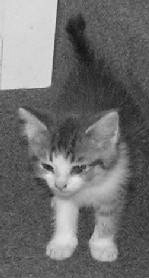

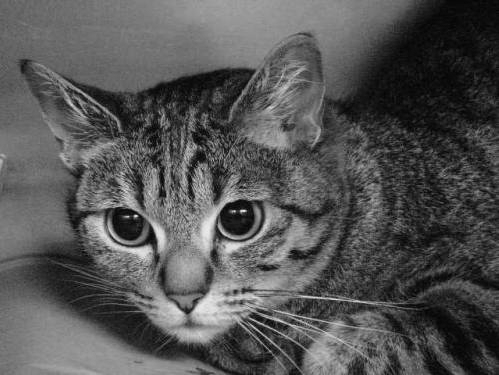

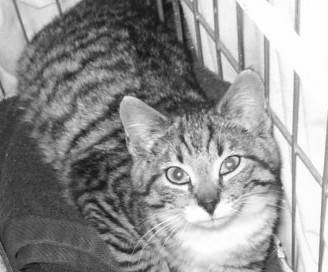

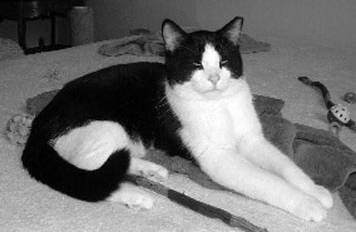

In [64]:
for img in img_paths:
  image = Image.open(img)
  rgb_img = np.array(image)
  gray_img = 0.3 * rgb_img[:, :, 0] + 0.59 * rgb_img[:, :, 1] + 0.11 * rgb_img[:, :, 2]
  gray_img = Image.fromarray(gray_img)
  gray_img = np.clip(gray_img, 0, 255)
  gray_img = gray_img.astype(np.uint8)
  cv2_imshow(gray_img)

**Convolution**

In [65]:
from skimage import io, color

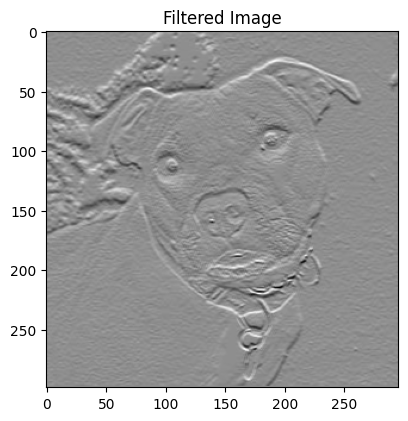

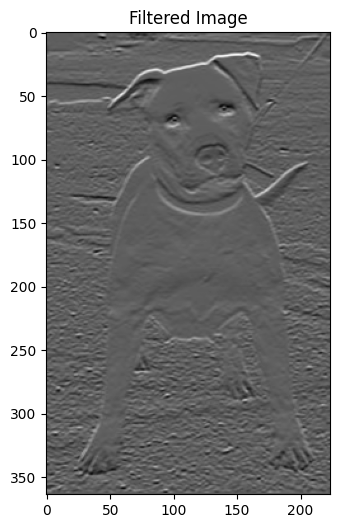

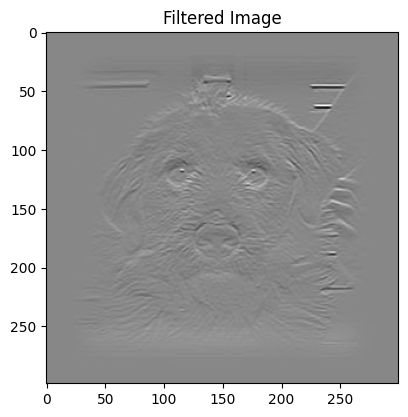

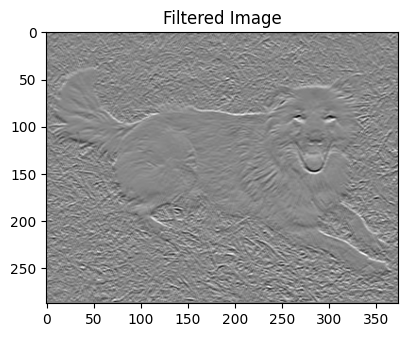

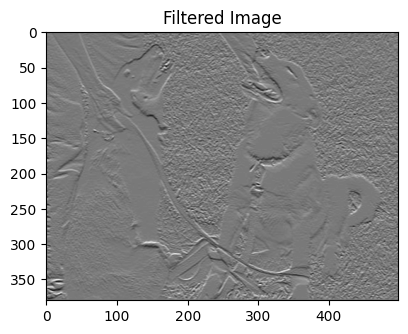

...

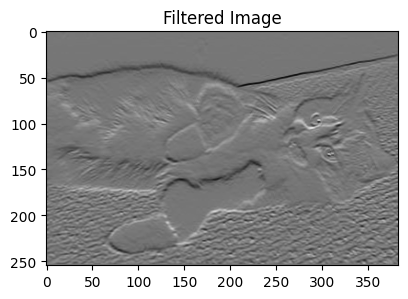

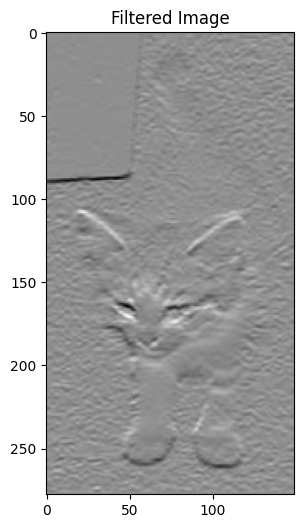

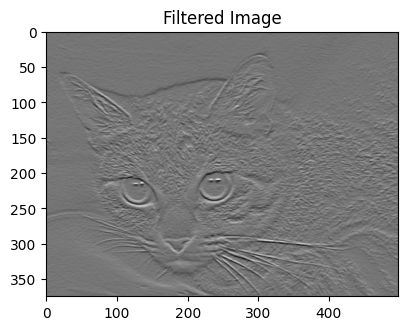

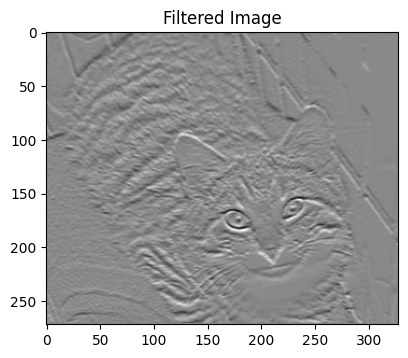

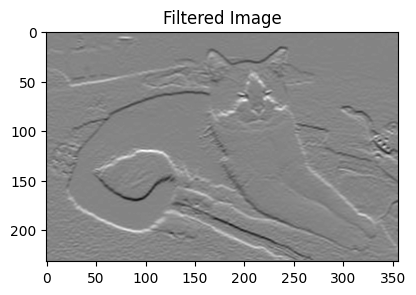

In [81]:
for img in img_paths:
  image = io.imread(img)
  gray_img = color.rgb2gray(image)
  kernel = np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]])
  filtered_image = cv2.filter2D(gray_img, -1, kernel)
  plt.figure(figsize=(10, 6))
  plt.subplot(1, 2, 1)
  plt.imshow(filtered_image, cmap='gray')
  plt.title("Filtered Image")
  plt.show()

**Correlation**

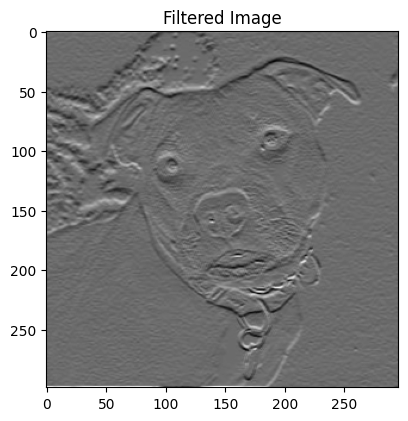

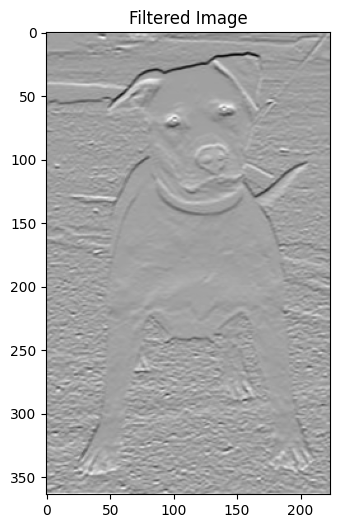

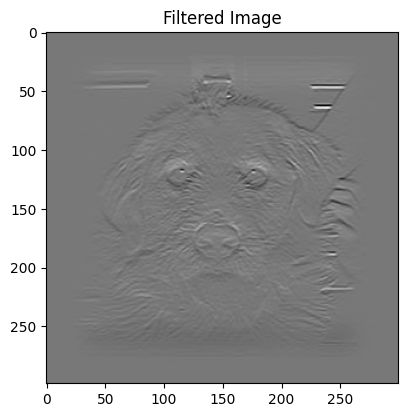

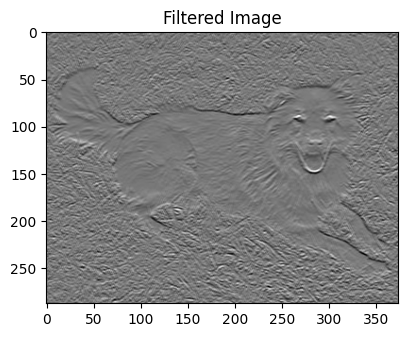

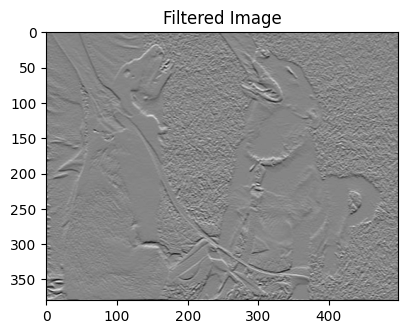

...

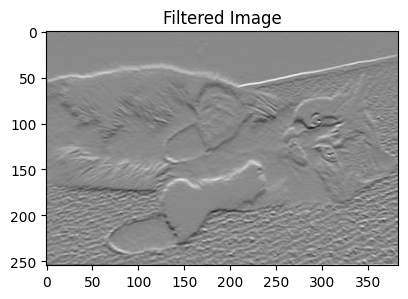

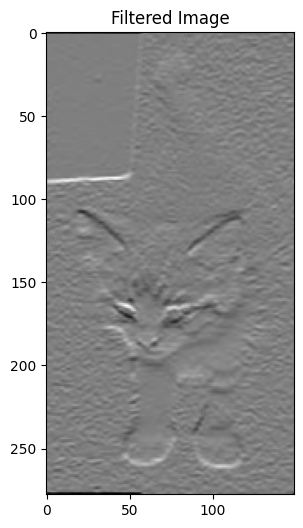

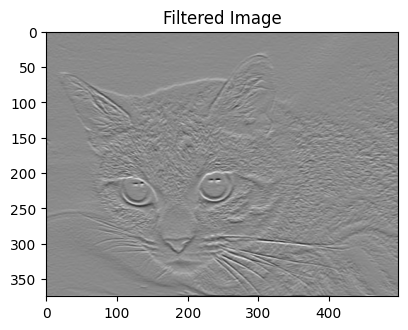

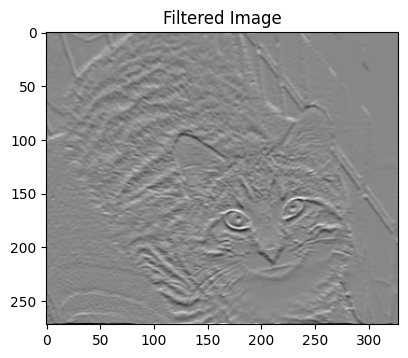

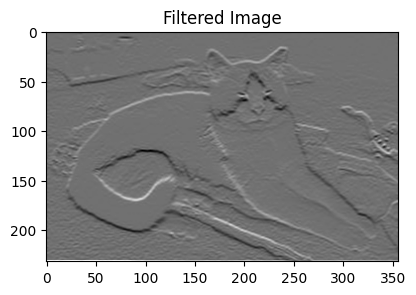

In [86]:
from scipy.signal import correlate2d
for img in img_paths:
  image = io.imread(img)
  gray_img = color.rgb2gray(image)
  kernel = np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]])
  correlated_image = correlate2d(gray_img, kernel, mode='same', boundary='wrap')
  plt.figure(figsize=(10, 6))
  plt.subplot(1, 2, 1)
  plt.imshow(correlated_image, cmap='gray')
  plt.title("Filtered Image")
  plt.show()

**1st order derivative and 2nd Order derivative filter**

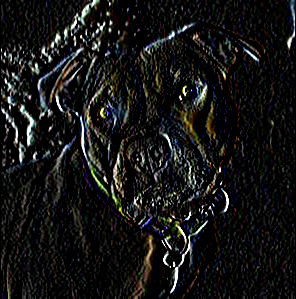

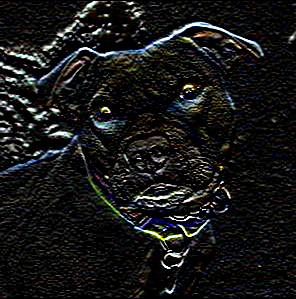

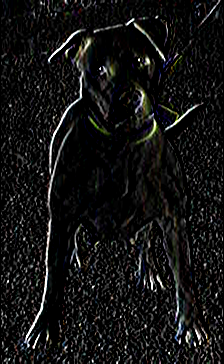

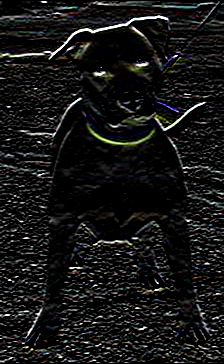

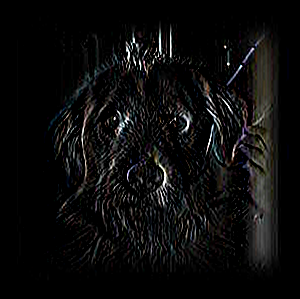

...

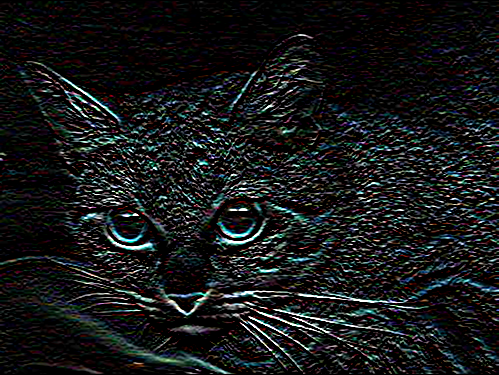

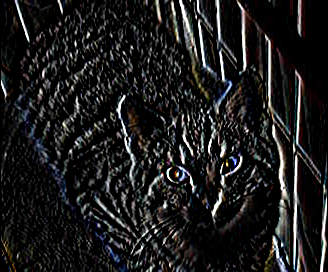

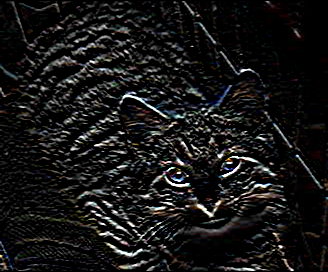

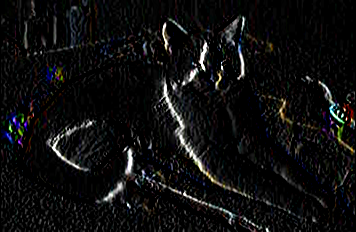

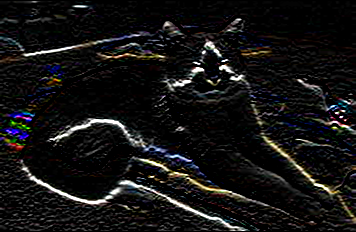

In [68]:
for img in img_paths:
  image = io.imread(img)
  kernel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
  kernel_y = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])
  dx = cv2.filter2D(image, -1, kernel_x)
  dy = cv2.filter2D(image, -1, kernel_y)
  cv2_imshow(dx)
  cv2_imshow(dy)
  cv2.waitKey(0)
  cv2.destroyAllWindows()


**Identify the type of noise (Gaussian or Salt and Pepper) in images.**


In [69]:
def identify_noise_type(image):
    hist = cv2.calcHist([image], [0], None, [256], [0, 256])
    min_peak = hist.argmin()
    max_peak = hist.argmax()
    if min_peak == 0 and max_peak == 255:
        return "Salt and Pepper"
    else:
        return "Gaussian"



**Apply relative filter on input images to remove the noise.**

Noise Type in /1.jpg: Gaussian
Original Image - /1.jpg


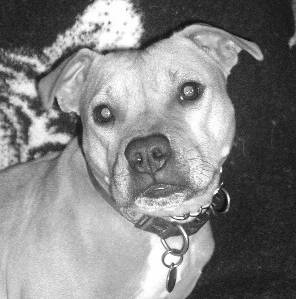

Filtered Image (Gaussian) - /1.jpg


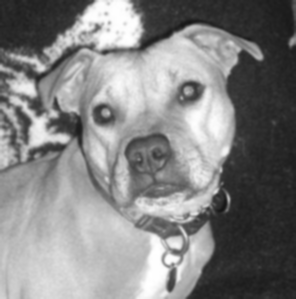

Noise Type in /2.jpg: Gaussian
Original Image - /2.jpg


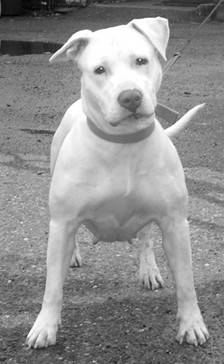

Filtered Image (Gaussian) - /2.jpg


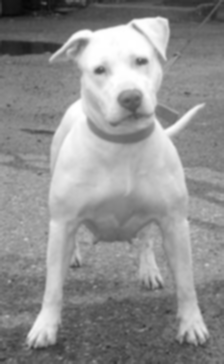

Noise Type in /3.jpg: Gaussian
Original Image - /3.jpg


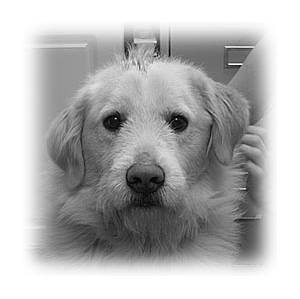

Filtered Image (Gaussian) - /3.jpg


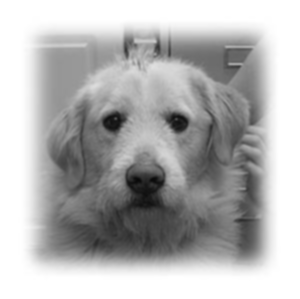

Noise Type in /4.jpg: Gaussian
Original Image - /4.jpg


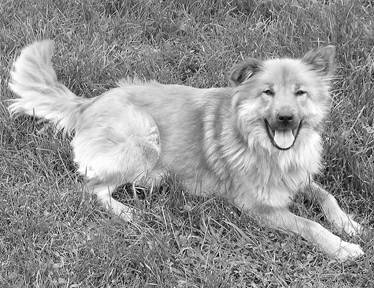

Filtered Image (Gaussian) - /4.jpg


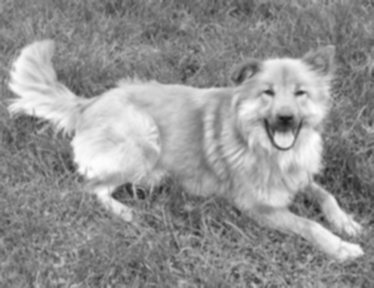

Noise Type in /5.jpg: Gaussian
Original Image - /5.jpg


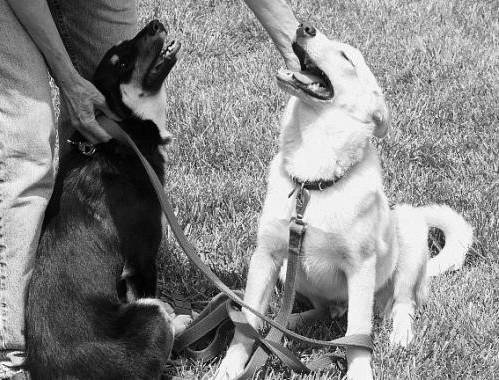

Filtered Image (Gaussian) - /5.jpg


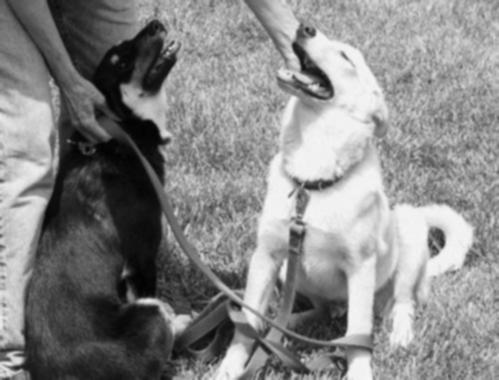

Noise Type in /6.jpg: Gaussian
Original Image - /6.jpg


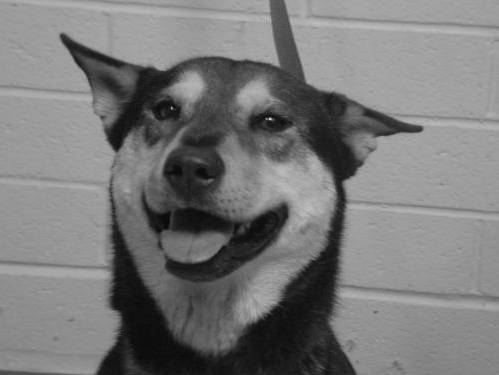

Filtered Image (Gaussian) - /6.jpg


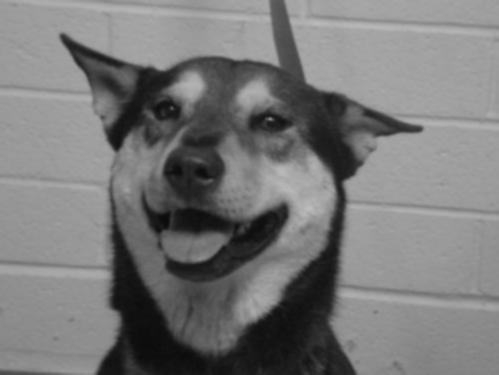

Noise Type in /7.jpg: Gaussian
Original Image - /7.jpg


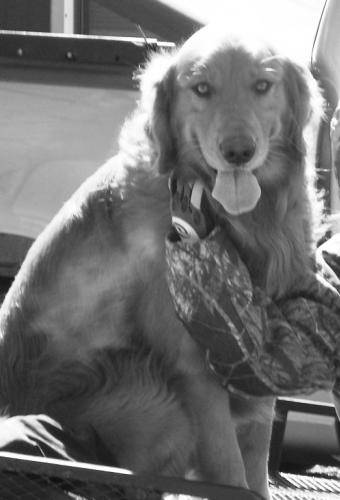

Filtered Image (Gaussian) - /7.jpg


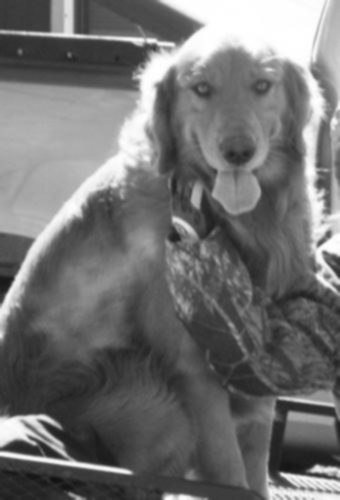

Noise Type in /8.jpg: Gaussian
Original Image - /8.jpg


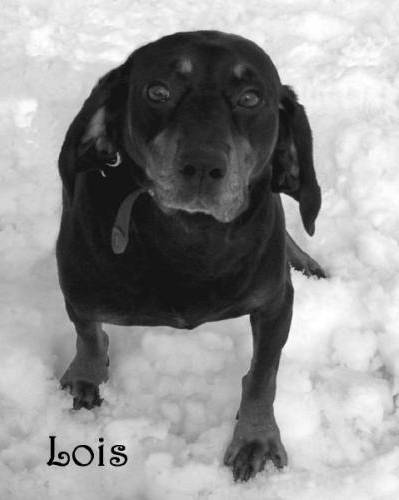

Filtered Image (Gaussian) - /8.jpg


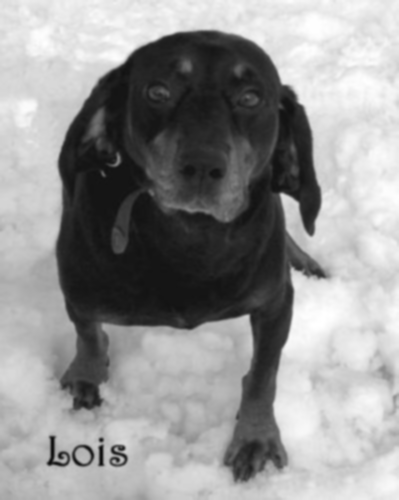

Noise Type in /9.jpg: Gaussian
Original Image - /9.jpg


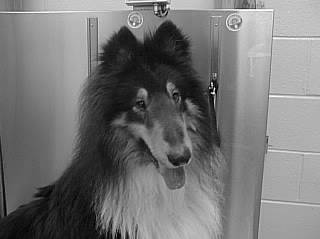

Filtered Image (Gaussian) - /9.jpg


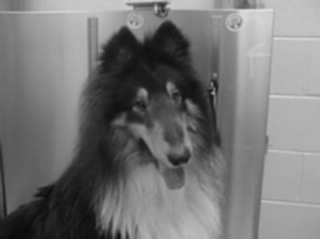

Noise Type in /10.jpg: Gaussian
Original Image - /10.jpg


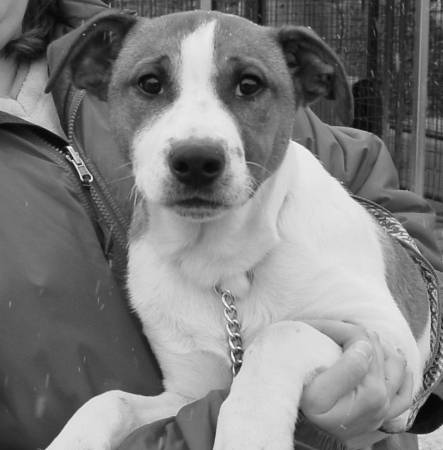

Filtered Image (Gaussian) - /10.jpg


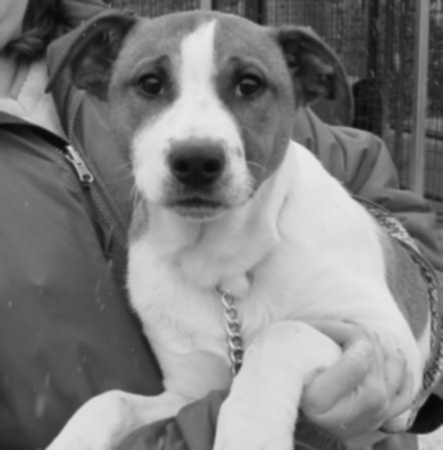

Noise Type in /1.jpg: Gaussian
Original Image - /1.jpg


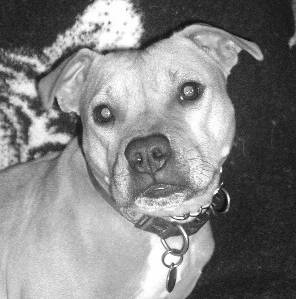

Filtered Image (Gaussian) - /1.jpg


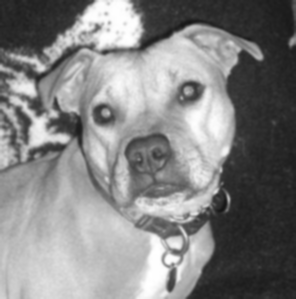

Noise Type in /11.jpg: Gaussian
Original Image - /11.jpg


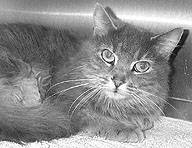

Filtered Image (Gaussian) - /11.jpg


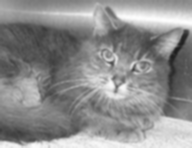

Noise Type in /12.jpg: Gaussian
Original Image - /12.jpg


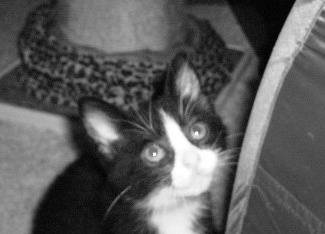

Filtered Image (Gaussian) - /12.jpg


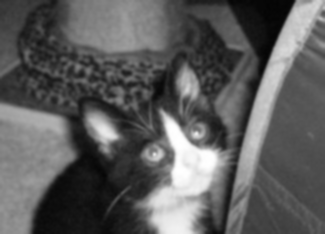

Noise Type in /13.jpg: Gaussian
Original Image - /13.jpg


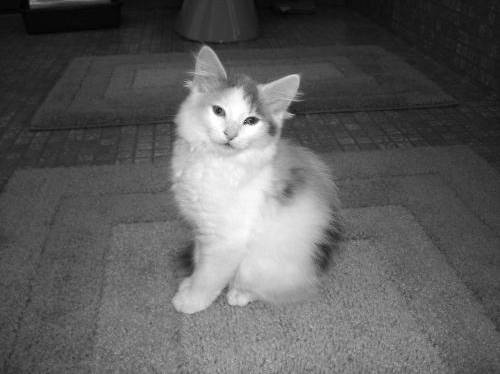

Filtered Image (Gaussian) - /13.jpg


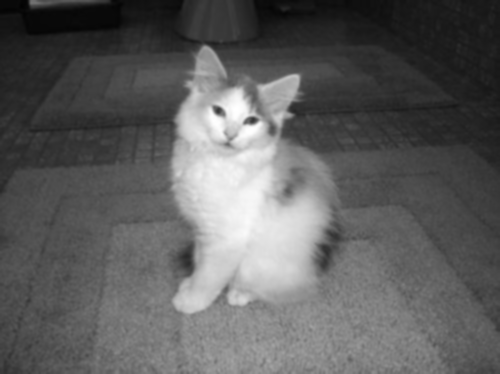

Noise Type in /14.jpg: Gaussian
Original Image - /14.jpg


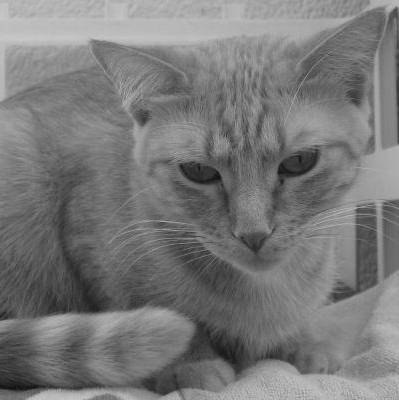

Filtered Image (Gaussian) - /14.jpg


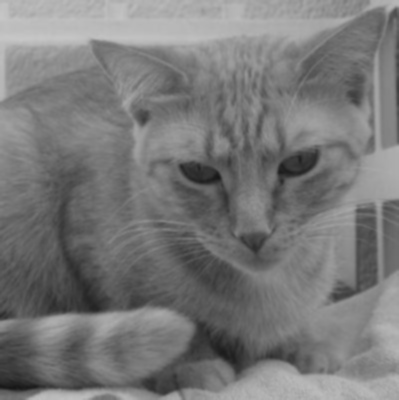

Noise Type in /15.jpg: Gaussian
Original Image - /15.jpg


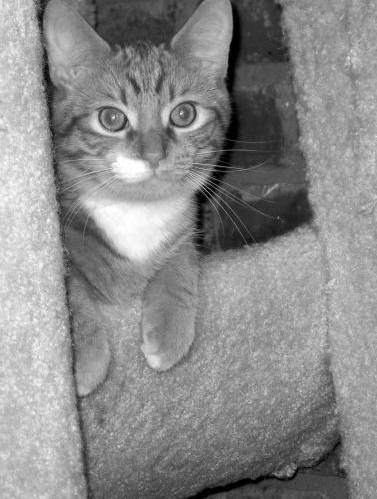

Filtered Image (Gaussian) - /15.jpg


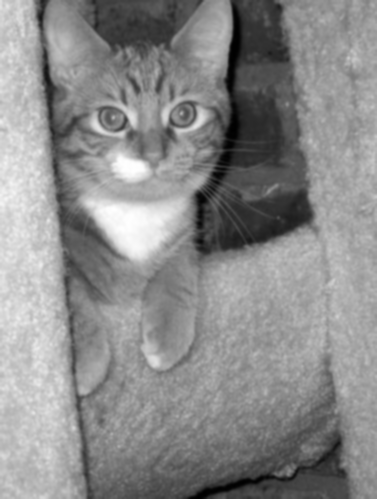

Noise Type in /16.jpg: Gaussian
Original Image - /16.jpg


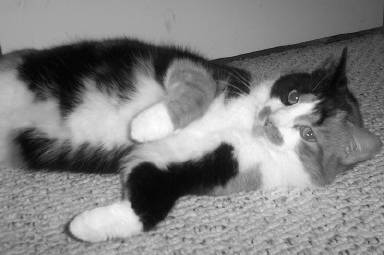

Filtered Image (Gaussian) - /16.jpg


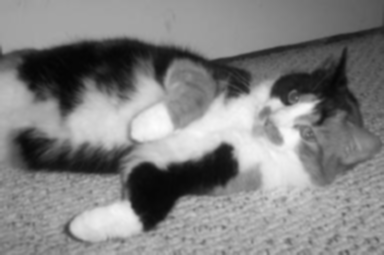

Noise Type in /17.jpg: Gaussian
Original Image - /17.jpg


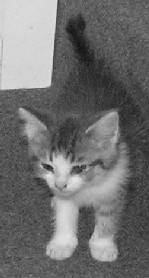

Filtered Image (Gaussian) - /17.jpg


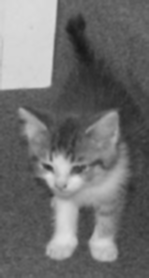

Noise Type in /18.jpg: Gaussian
Original Image - /18.jpg


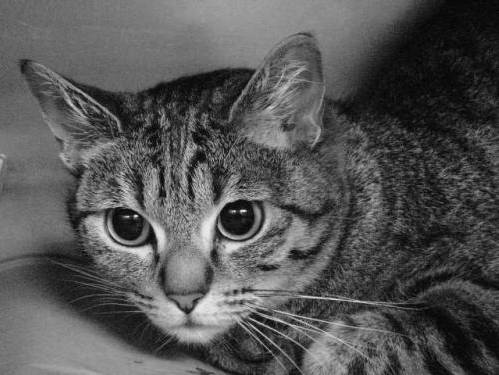

Filtered Image (Gaussian) - /18.jpg


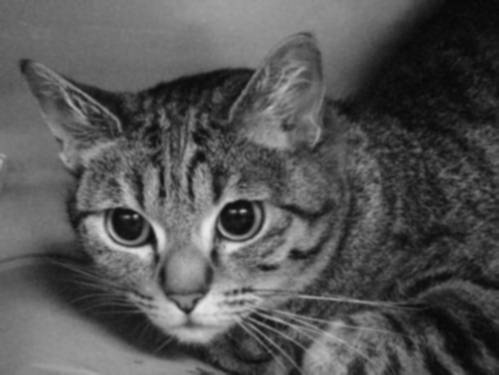

Noise Type in /19.jpg: Gaussian
Original Image - /19.jpg


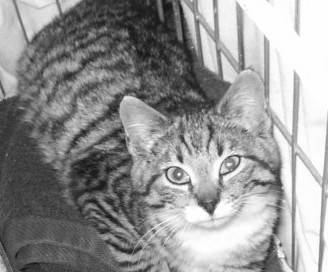

Filtered Image (Gaussian) - /19.jpg


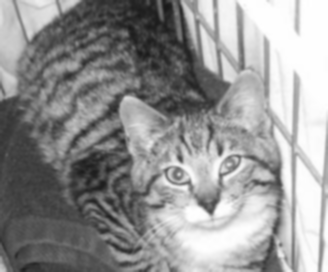

Noise Type in /20.jpg: Gaussian
Original Image - /20.jpg


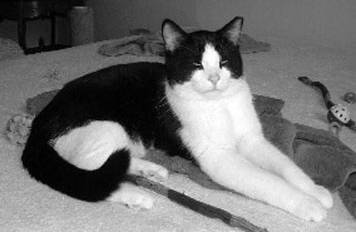

Filtered Image (Gaussian) - /20.jpg


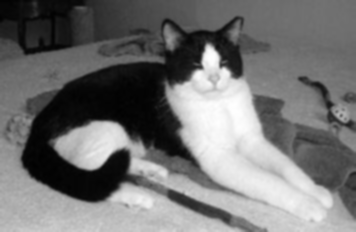

In [71]:
for img in img_paths:
    # Read the image
    image = cv2.imread(img, cv2.IMREAD_GRAYSCALE)

    noise_type = identify_noise_type(image)

    print(f"Noise Type in {img}: {noise_type}")

    if noise_type == "Salt and Pepper":
        filtered_image = cv2.medianBlur(image, 5)
    else:
        filtered_image = cv2.GaussianBlur(image, (5, 5), 0)


    print(f"Original Image - {img}")
    cv2_imshow(image)
    print(f"Filtered Image ({noise_type}) - {img}")
    cv2_imshow(filtered_image)
    cv2.waitKey(0)

    cv2.destroyAllWindows()

**Laplacian edge detection**

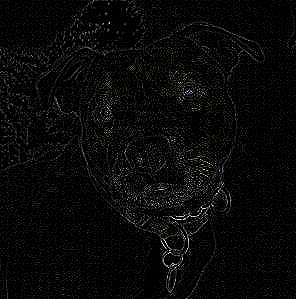

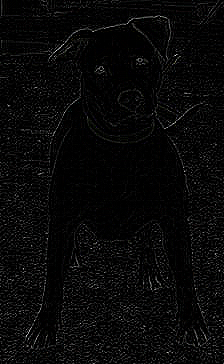

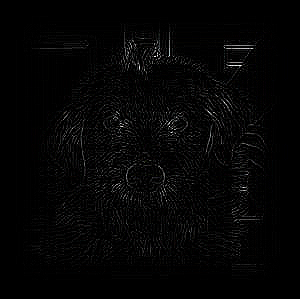

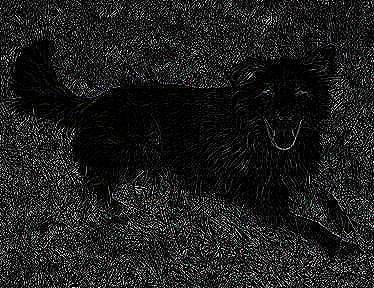

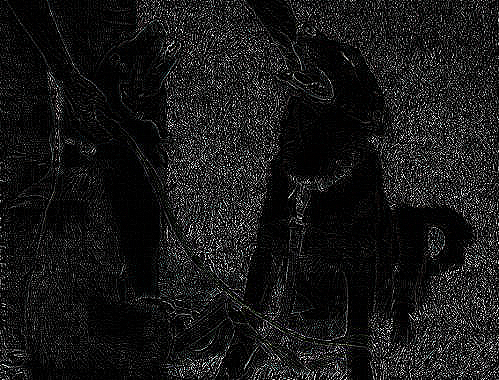

...

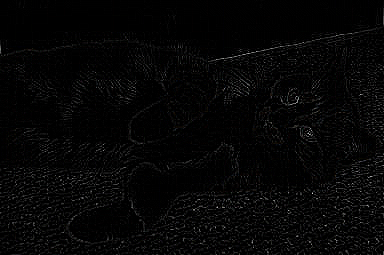

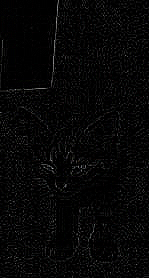

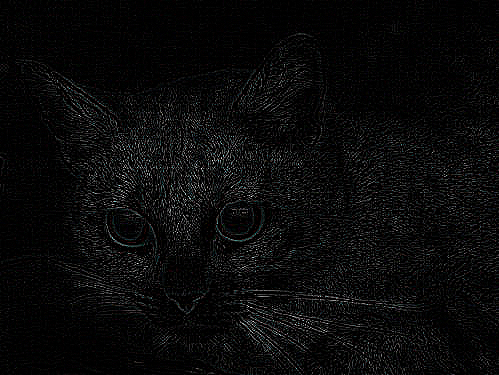

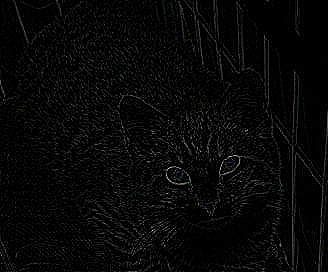

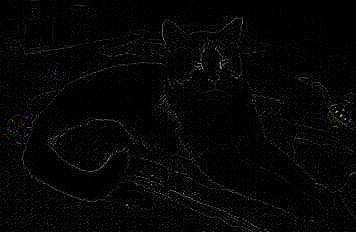

In [51]:
for img in img_paths:
  image = io.imread(img)
  laplacian_kernel = np.array([[0, 1, 0], [1, -4, 1], [0, 1, 0]])
  laplacian = cv2.filter2D(image, -1, laplacian_kernel)
  cv2_imshow(laplacian)
  cv2.waitKey(0)
  cv2.destroyAllWindows()
  cv2.waitKey(0)
  cv2.destroyAllWindows()
